## Things to try and analyze
- Show the graph of the metric as the portions of insalient and outsalient varies. Could be that there is a bit of a jump in the metric value somewhere? Some inconsistency.
- What are the failures (check when the objects are not globular, check when the object is small, check when the object is more than one?)
- How does the metric fair against comparison of ground truth vs. the model?
- Check how does the model fair when using 1. ground truth vs. ViT and 2. ground truth vs. ResNet. Compare these two. It should be better when **ViT** is used since its saliency is more concentrated.
- Check how good is the automatic segmentation method (give statistics as to how much success rate it has)

### How does the metric fair against comparison of ground truth vs. the model?

In [7]:
import os
os.chdir("..")

In [8]:
from commons.api.utils import set_to_our_gpus, enable_web_access
set_to_our_gpus()
enable_web_access()

In [9]:
from PIL import Image
import torch
import numpy as np
import matplotlib.pyplot as plt

from ultralytics import YOLO

from commons.api.segment_saliency import generate_segmentation_mask, pixels_to_polygon, polygon_to_pixels, generate_saliency_from_polygon, plot_polygon
from commons.api.imagenet_tiny import get_imagenet_classes, get_random_images
from commons.api.vit import load_vit
from commons.api.viz import visualize_saliency_overlay
from commons.api.method.attention_rollout import rollout, grad_rollout, vit_saliency_map
from commons.api.metric.ior import insalient_outsalient_ratio

os.chdir("abid")

In [10]:
vit_model = load_vit()

Using cache found in /home/hashimi/.cache/torch/hub/facebookresearch_deit_main


In [11]:
model = YOLO('yolov8m-seg.pt')

def generate_yolo_segmentation_mask(model, img_input):
    results = model(img_input)
    if results[0].masks != None:
        return np.array(Image.fromarray(results[0].masks.cpu().data[0].numpy()).resize((224, 224)))
    else:
        return results[0].masks

In [12]:
classes = get_imagenet_classes()

lesser_panda


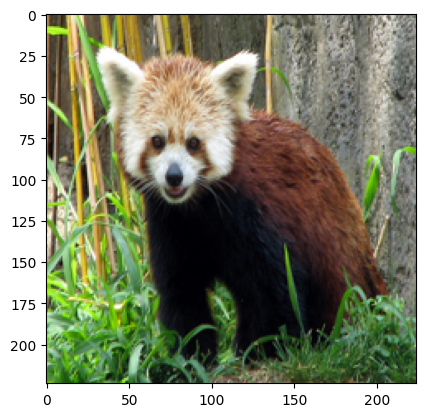

In [41]:
sample_images, sample_labels = get_random_images(200)
sample_images = [np.array(Image.fromarray(image).resize((224, 224))) for image in sample_images]

idx = 0
plt.imshow(sample_images[idx])
print(classes[sample_labels[idx]])

In [42]:
len(sample_images)

200

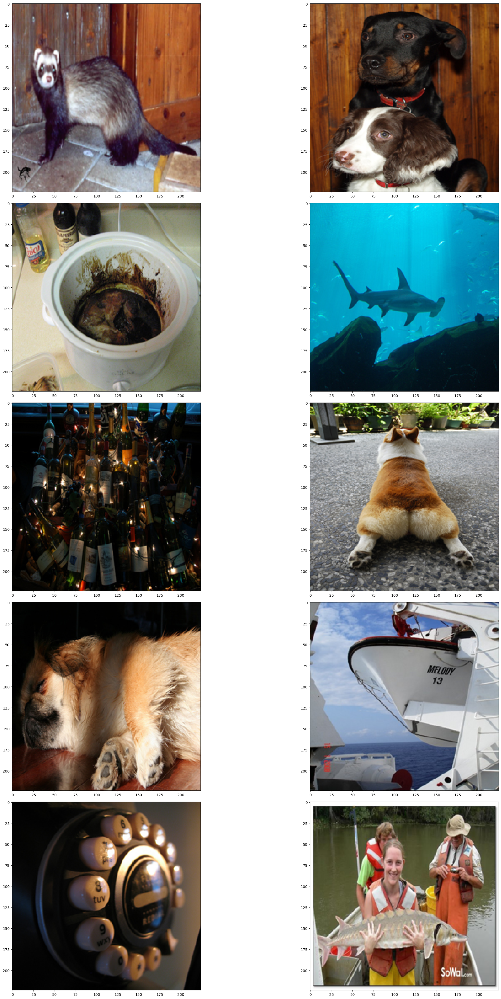

In [7]:
fig, axes = plt.subplots(ncols=2, nrows=5)
fig.set_figwidth(38)
fig.set_layout_engine('tight')
fig.set_figheight(38)
for i, ax in enumerate(axes.flat):
    ax.imshow(sample_images[i])


0: 640x640 1 dog, 15.8ms
Speed: 6.2ms preprocess, 15.8ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 dogs, 15.9ms
Speed: 2.6ms preprocess, 15.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 bottles, 1 cup, 1 bowl, 1 cell phone, 15.9ms
Speed: 2.7ms preprocess, 15.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 airplane, 15.8ms
Speed: 2.7ms preprocess, 15.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 17 bottles, 15.9ms
Speed: 2.8ms preprocess, 15.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog, 5 potted plants, 15.8ms
Speed: 2.7ms preprocess, 15.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog, 30.7ms
Speed: 2.8ms preprocess, 30.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 airplanes, 16.9ms
Speed: 2.1ms preprocess, 16.9ms inference, 1.9

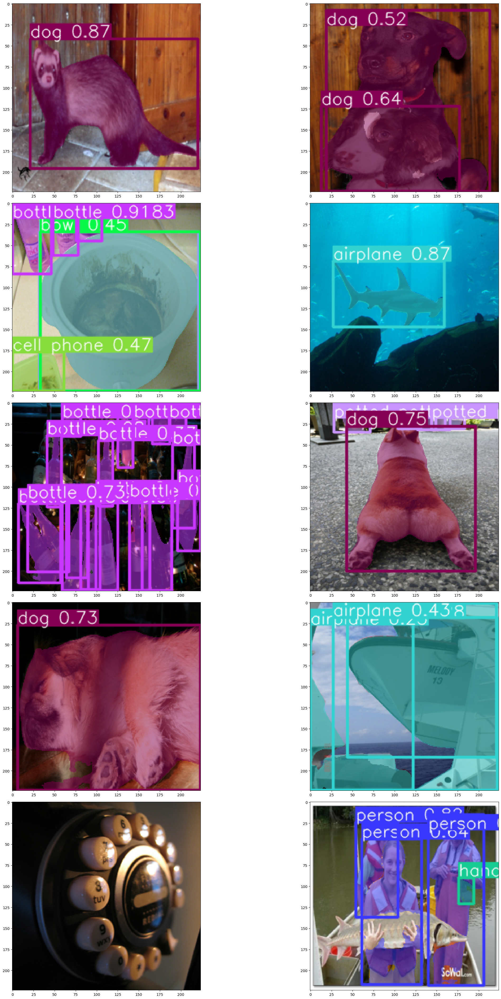

In [9]:
fig, axes = plt.subplots(ncols=2, nrows=5)
fig.set_figwidth(38)
fig.set_layout_engine('tight')
fig.set_figheight(38)

for i, ax in enumerate(axes.flat):
    results = model(sample_images[i]);
    ax.imshow(results[0].plot());


0: 640x640 2 birds, 15.9ms
Speed: 2.1ms preprocess, 15.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


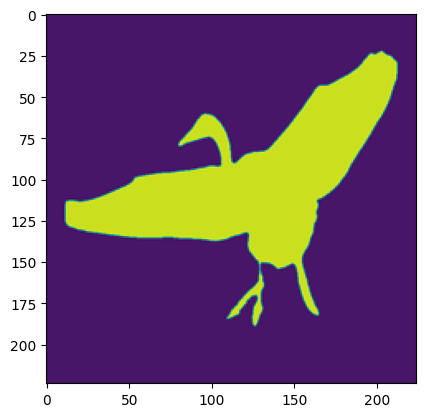

In [147]:
sample_image = sample_images[0]
mask = generate_yolo_segmentation_mask(model, sample_image)
plt.imshow(mask)

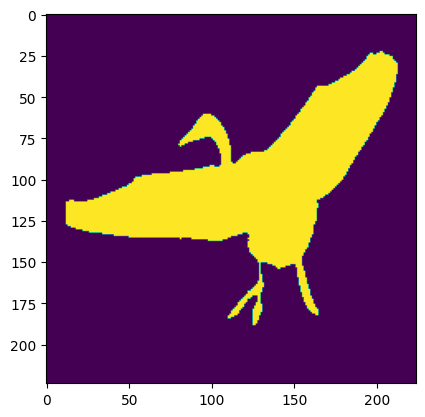

In [142]:
poly_mask = pixels_to_polygon(mask)
pixel_mask = polygon_to_pixels(poly_mask, mask.shape[0], mask.shape[1])
plt.imshow(pixel_mask)

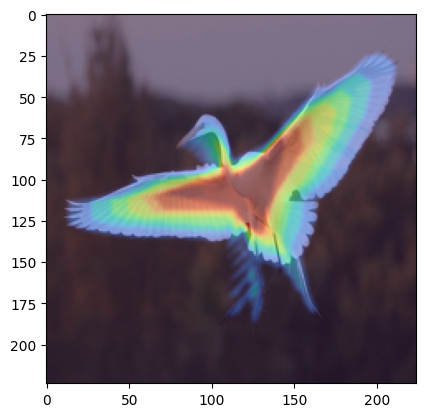

In [143]:
saliency = generate_saliency_from_polygon(poly_mask, sample_image.shape[0], sample_image.shape[1])
visualize_saliency_overlay(plt.gca(), sample_image, saliency);


0: 640x640 1 dog, 16.5ms
Speed: 18.4ms preprocess, 16.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 dogs, 16.8ms
Speed: 3.6ms preprocess, 16.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 bottles, 1 cup, 1 bowl, 1 cell phone, 16.3ms
Speed: 3.2ms preprocess, 16.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
/scratch/hashimi/python/lib/python3.8/site-packages/shapely/predicates.py:540: RuntimeWarning: invalid value encountered in contains
  return lib.contains(a, b, **kwargs)

0: 640x640 1 airplane, 16.7ms
Speed: 3.4ms preprocess, 16.7ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 17 bottles, 16.4ms
Speed: 3.3ms preprocess, 16.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog, 5 potted plants, 16.0ms
Speed: 2.4ms preprocess, 16.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog, 15.9ms
Spe

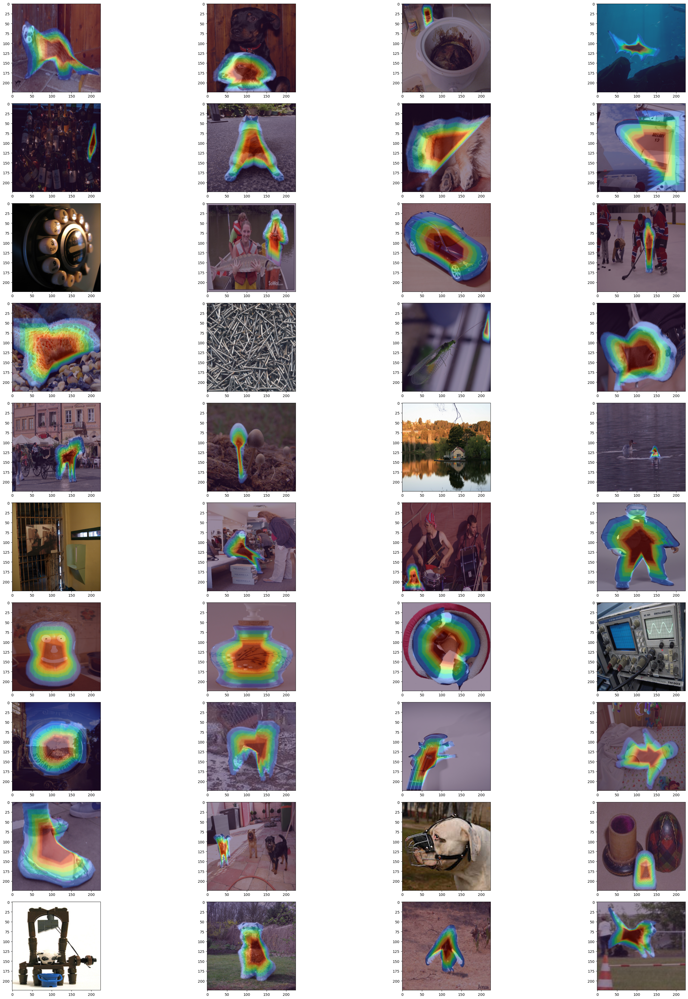

In [10]:
fig, axes = plt.subplots(ncols=4, nrows=10)
fig.set_figwidth(38)
fig.set_layout_engine('tight')
fig.set_figheight(38)

for i, ax in enumerate(axes.flat):
    sample_image = sample_images[i]
    mask = generate_yolo_segmentation_mask(model, sample_image)
    if type(mask) == type(None):
        ax.imshow(sample_image);
    else:
        poly_mask = pixels_to_polygon(mask)
        saliency = generate_saliency_from_polygon(poly_mask, sample_image.shape[0], sample_image.shape[1])
        visualize_saliency_overlay(ax, sample_image, saliency);
fig.show()

In [44]:
saliencies = []
segmentable_image_indicies = []
for idx in range(len(sample_images)):
    sample_image = sample_images[idx]
    mask = generate_yolo_segmentation_mask(model, sample_image)
    if type(mask) != type(None):
        poly_mask = pixels_to_polygon(mask)
        saliency = generate_saliency_from_polygon(poly_mask, sample_image.shape[0], sample_image.shape[1])
        saliencies.append(saliency)
        segmentable_image_indicies.append(idx)


0: 640x640 1 bear, 15.8ms
Speed: 2.4ms preprocess, 15.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 16.0ms
Speed: 2.6ms preprocess, 16.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 toilet, 16.0ms
Speed: 2.6ms preprocess, 16.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat, 16.1ms
Speed: 6.2ms preprocess, 16.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 birds, 19.6ms
Speed: 2.8ms preprocess, 19.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)
/scratch/hashimi/python/lib/python3.8/site-packages/shapely/predicates.py:540: RuntimeWarning: invalid value encountered in contains
  return lib.contains(a, b, **kwargs)

0: 640x640 1 dog, 16.4ms
Speed: 2.9ms preprocess, 16.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 1 bed, 16.1ms
Speed: 2.6ms preprocess, 16.1ms inference, 1.8ms

Speed: 2.5ms preprocess, 16.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog, 16.0ms
Speed: 3.3ms preprocess, 16.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 banana, 16.4ms
Speed: 2.9ms preprocess, 16.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 16.0ms
Speed: 2.5ms preprocess, 16.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 orange, 1 mouse, 16.0ms
Speed: 2.6ms preprocess, 16.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat, 16.0ms
Speed: 3.9ms preprocess, 16.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 16.0ms
Speed: 2.5ms preprocess, 16.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 16.0ms
Speed: 3.3ms preprocess, 16.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3


0: 640x640 11 persons, 3 chairs, 1 dining table, 16.0ms
Speed: 2.4ms preprocess, 16.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 16.0ms
Speed: 2.5ms preprocess, 16.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 1 elephant, 15.8ms
Speed: 2.6ms preprocess, 15.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 16.0ms
Speed: 3.2ms preprocess, 16.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 16.6ms
Speed: 3.0ms preprocess, 16.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 suitcase, 1 cup, 1 bowl, 16.0ms
Speed: 2.5ms preprocess, 16.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 16.0ms
Speed: 2.5ms preprocess, 16.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 16.1ms
Speed: 2.5ms preprocess,


0: 640x640 1 bird, 16.0ms
Speed: 2.5ms preprocess, 16.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 16.0ms
Speed: 2.4ms preprocess, 16.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 oven, 16.0ms
Speed: 2.5ms preprocess, 16.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 16.0ms
Speed: 2.5ms preprocess, 16.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 wine glass, 15.8ms
Speed: 2.4ms preprocess, 15.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1 truck, 16.1ms
Speed: 3.1ms preprocess, 16.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 16.4ms
Speed: 2.8ms preprocess, 16.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 15.9ms
Speed: 2.7ms preprocess, 15.9ms inference, 1.8ms postprocess per image

In [45]:
len(saliencies)

150

In [20]:
obj_masks = []
for idx in range(len(images)):
    sample_image = images[idx]
    mask = generate_yolo_segmentation_mask(model, sample_image)
    if type(mask) != type(None):
        obj_masks.append(mask)


0: 640x640 1 bear, 15.8ms
Speed: 4.4ms preprocess, 15.8ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 15.9ms
Speed: 2.1ms preprocess, 15.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 toilet, 15.9ms
Speed: 2.1ms preprocess, 15.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat, 15.9ms
Speed: 2.0ms preprocess, 15.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 birds, 15.6ms
Speed: 2.1ms preprocess, 15.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dog, 15.6ms
Speed: 2.1ms preprocess, 15.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 1 bed, 15.6ms
Speed: 2.1ms preprocess, 15.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 15.6ms
Speed: 2.1ms preprocess, 15.6ms inference, 0.4ms postprocess per image at shape (1, 3,


0: 640x640 1 banana, 13.0ms
Speed: 2.0ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 12.9ms
Speed: 2.0ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 orange, 1 mouse, 13.0ms
Speed: 2.0ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cat, 13.0ms
Speed: 2.0ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 13.3ms
Speed: 2.0ms preprocess, 13.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 13.5ms
Speed: 2.0ms preprocess, 13.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 birds, 13.1ms
Speed: 2.2ms preprocess, 13.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 cell phone, 13.0ms
Speed: 2.0ms preprocess, 13.0ms inference, 1.5ms postprocess per image at s

Speed: 2.1ms preprocess, 14.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 1 elephant, 13.8ms
Speed: 2.2ms preprocess, 13.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 13.7ms
Speed: 2.0ms preprocess, 13.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 13.4ms
Speed: 2.0ms preprocess, 13.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 suitcase, 1 cup, 1 bowl, 13.4ms
Speed: 2.0ms preprocess, 13.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 13.2ms
Speed: 2.0ms preprocess, 13.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 13.1ms
Speed: 2.0ms preprocess, 13.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 13.4ms
Speed: 2.1ms preprocess, 13.4ms inference, 0.4ms postprocess per image at shape (

In [47]:
# Saving the images and saliencies
np.save('data/ground_saliency_images/ground_saliencies_2.npy', np.array(saliencies))
np.save('data/ground_saliency_images/images_2.npy', np.array([sample_images[idx] for idx in range(len(segmentable_image_indicies))]))
np.save('data/ground_saliency_images/obj_masks_2.npy', np.array(obj_masks))

In [20]:
ground_saliencies = np.load('data/ground_saliency_images/ground_saliencies_2.npy')
images = np.load('data/ground_saliency_images/images_2.npy')
obj_masks = np.load('data/ground_saliency_images/obj_masks_2.npy')

In [131]:
img = Image.fromarray(sample_images[4])

for idx in range(images.shape[0]):
    vit_probs, vit_idx, (vit_cls_mask, vit_distill_mask) = vit_saliency_map(Image.fromarray(img[idx]), vit_model)

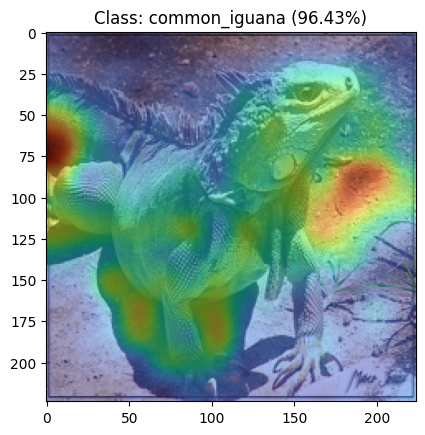

In [74]:
idx = 18
vit_probs, vit_idx, (vit_cls_mask, vit_distill_mask) = vit_saliency_map(Image.fromarray(images[idx]), vit_model)
visualize_saliency_overlay(plt.gca(), Image.fromarray(images[idx]), vit_cls_mask, vit_probs, vit_idx, classes);

In [21]:
from io import BytesIO
import matplotlib.pyplot as plt
from matplotlib.figure import Figure
from matplotlib.transforms import IdentityTransform

def text_to_rgba(s, *, dpi, **kwargs):
    # To convert a text string to an image, we can:
    # - draw it on an empty and transparent figure;
    # - save the figure to a temporary buffer using ``bbox_inches="tight",
    #   pad_inches=0`` which will pick the correct area to save;
    # - load the buffer using ``plt.imread``.
    #
    # (If desired, one can also directly save the image to the filesystem.)
    fig = Figure(facecolor="none", figsize=(10, 10))
    fig.text(0, 0, s, **kwargs)
    with BytesIO() as buf:
        fig.savefig(buf, dpi=dpi, format="png", bbox_inches="tight",
                    pad_inches=0)
        buf.seek(0)
        rgba = plt.imread(buf)
    return rgba

In [22]:
def insalient_outsalient_ratio_new(reference, comparative, object_mask):
    assert(reference.shape == comparative.shape)
#     ref_tmp = Image.fromarray(reference.squeeze()).resize(comparative.shape)
#     ref = np.array(ref_tmp)

    agreement = reference + comparative
#     plt.imshow(inter_model_saliency)

    epsilon = 1e-9
    insalient_agreement = (agreement * object_mask) + epsilon
#     insalient_agreement_norm = insalient_agreement / insalient_agreement.max()
#     insalient_agreement_norm = np.where(insalient_agreement_norm >= 0.9, 1, insalient_agreement_norm)

    reference_in_distribution = (reference * object_mask) + epsilon
    reference_in_distribution = reference_in_distribution / reference_in_distribution.sum()

    insalient = np.sum(insalient_agreement * reference_in_distribution)

    outsalient_agreement = (agreement * np.logical_not(object_mask).astype(float)) + epsilon
#     outsalient_agreement_norm = outsalient_agreement / outsalient_agreement.max()
#     outsalient_agreement_norm = np.where(outsalient_agreement_norm >= 0.9, 1, outsalient_agreement_norm)

    reference_out_distribution = (reference * np.logical_not(object_mask).astype(float)) + epsilon
    reference_out_distribution = reference_out_distribution / reference_out_distribution.sum()

    outsalient = np.sum(outsalient_agreement * reference_out_distribution)

    return insalient / (insalient + outsalient)


def ior_singluar(saliency, object_mask):
    epsilon = 1e-9
    inner_saliency = (saliency * object_mask) + epsilon
    outer_saliency = saliency * np.logical_not(object_mask).astype(float)
    
    return np.sum(inner_saliency) / (np.sum(inner_saliency) + np.sum(outer_saliency))

### IOR

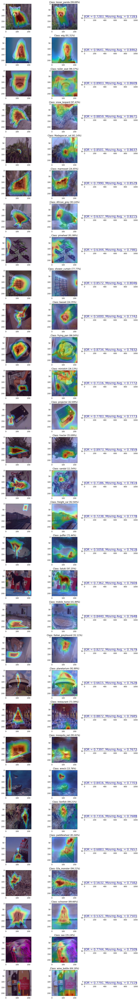

In [10]:
ior_values = np.array([])
fig, axes = plt.subplots(ncols=3, nrows=30)
fig.set_figwidth(12)
fig.set_layout_engine('tight')
fig.set_figheight(80)

for row in range(axes.shape[0]):
    visualize_saliency_overlay(axes[row, 0], Image.fromarray(images[row]), ground_saliencies[row])
    vit_probs, vit_idx, (vit_cls_mask, vit_distill_mask) = vit_saliency_map(Image.fromarray(images[row]), vit_model)
    visualize_saliency_overlay(axes[row, 1], Image.fromarray(images[row]), vit_cls_mask, vit_probs, vit_idx, classes);
    
    resized_vit_cls_mask = np.array(Image.fromarray(vit_cls_mask).resize((228, 228)))
    resized_obj_mask = np.array(Image.fromarray(obj_masks[row]).resize((228, 228)))
    ior = insalient_outsalient_ratio_new(ground_saliencies[row], resized_vit_cls_mask, resized_obj_mask)
    ior_values = np.append(ior_values, ior)
    text = f"IOR = {ior:.4f}, Moving Avg. = {ior_values.sum()/ior_values.shape[0]:.4f}"
    
    axes[row, 2].imshow(text_to_rgba(text, color="blue", fontsize=20, dpi=200))
fig.show()

### IOR Singular

In [ ]:
ior_singular_values = np.array([])
fig, axes = plt.subplots(ncols=3, nrows=30)
fig.set_figwidth(12)
fig.set_layout_engine('tight')
fig.set_figheight(80)

for row in range(axes.shape[0]):
    resized_obj_mask = np.array(Image.fromarray(obj_masks[row]).resize((228, 228)))
    visualize_saliency_overlay(axes[row, 0], Image.fromarray(images[row]), resized_obj_mask);
    
    vit_probs, vit_idx, (vit_cls_mask, vit_distill_mask) = vit_saliency_map(Image.fromarray(images[row]), vit_model)
    visualize_saliency_overlay(axes[row, 1], Image.fromarray(images[row]), vit_cls_mask, vit_probs, vit_idx, classes);
    
    resized_vit_cls_mask = np.array(Image.fromarray(vit_cls_mask).resize((228, 228)))
    ior = ior_singluar(resized_vit_cls_mask, resized_obj_mask)
    ior_singular_values = np.append(ior_singular_values, ior)
    text = f"IOR = {ior:.4f}, Moving Avg. = {(ior_singular_values.sum()/ior_singular_values.shape[0]):.4f}"
    
    axes[row, 2].imshow(text_to_rgba(text, color="blue", fontsize=20, dpi=200))
fig.show()

In [90]:
mask = generate_yolo_segmentation_mask(model, sample_image)
poly_mask = pixels_to_polygon(mask)
saliency = generate_saliency_from_polygon(poly_mask, sample_image.shape[0], sample_image.shape[1])
saliencies.append(saliency)
segmentable_image_indicies.append(idx)

(4, 3)

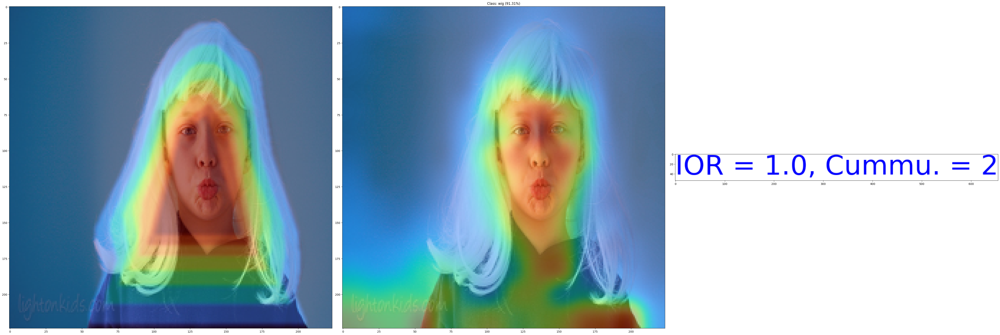

In [13]:
fig, axes = plt.subplots(ncols=3, nrows=1)
fig.set_figwidth(50)
fig.set_layout_engine('tight')
fig.set_figheight(50)

row = 1
visualize_saliency_overlay(axes[0], Image.fromarray(images[row]), ground_saliencies[row])
vit_probs, vit_idx, (vit_cls_mask, vit_distill_mask) = vit_saliency_map(Image.fromarray(images[row]), vit_model)
visualize_saliency_overlay(axes[1], Image.fromarray(images[row]), vit_cls_mask, vit_probs, vit_idx, classes);

resized_vit_cls_mask = np.array(Image.fromarray(vit_cls_mask).resize((228, 228)))
resized_obj_mask = np.array(Image.fromarray(obj_masks[row]).resize((228, 228)))
ior = insalient_outsalient_ratio(resized_vit_cls_mask, ground_saliencies[row], resized_obj_mask)
text = f"IOR = {ior:.4f}, Moving Avg. = "
axes[2].imshow(text_to_rgba(text, color="blue", fontsize=20, dpi=200))
fig.show()

In [14]:
ior

1.0

In [19]:
reference = resized_vit_cls_mask
comparative = ground_saliencies[row]
object_mask = resized_obj_mask

agreement = reference * comparative
#     plt.imshow(inter_model_saliency)

insalient_agreement = (agreement * object_mask)
insalient_agreement_norm = insalient_agreement / insalient_agreement.max()
insalient_agreement_norm = np.where(insalient_agreement_norm >= 0.9, 1, insalient_agreement_norm)

reference_in_distribution = reference * object_mask
reference_in_distribution = reference_in_distribution / reference_in_distribution.sum()

insalient = np.sum(insalient_agreement_norm * reference_in_distribution)

outsalient_agreement = (agreement * np.logical_not(object_mask).astype(float)) + 1e-5
outsalient_agreement_norm = outsalient_agreement / outsalient_agreement.max()
outsalient_agreement_norm = np.where(outsalient_agreement_norm >= 0.9, 1, outsalient_agreement_norm)

reference_out_distribution = reference * np.logical_not(object_mask).astype(float)
reference_out_distribution = reference_out_distribution / reference_out_distribution.sum()

outsalient = np.sum(outsalient_agreement_norm * reference_out_distribution)

print(insalient / (insalient + outsalient))

0.24914361686113437


In [37]:
outsalient_agreement_norm.max()

1.0

In [35]:
insalient

0.5334569443064299

In [34]:
insalient_agreement_norm.sum()

21688.09080579673

In [32]:
np.exp(1)

2.718281828459045

In [41]:
np.log(np.e)

0.9999999999999999